# Outpainting notebook — Complete pipeline

Este notebook fornece um fluxo completo para **outpainting** (expansão de imagem) usando modelos de inpainting modernos (recomendado: SDXL Inpainting).  
Inclui instruções de instalação para Colab, função de expansão de canvas com máscara feathered, carregamento de pipeline compatível, exemplos de uso, estratégia multi-pass, pós-processamento com Real-ESRGAN (opcional) e métricas de avaliação.

**Observação:** execute a célula de instalação (Colab) se estiver em um ambiente limpo. Modelos grandes exigem GPU e memória.


In [39]:
import torch, gc
gc.collect()
torch.cuda.empty_cache()
torch.cuda.ipc_collect()

In [1]:
!rm -rf /usr/local/lib/python*/dist-packages/transformers
!rm -rf /usr/local/lib/python*/site-packages/transformers

In [2]:
!pip uninstall -y diffusers accelerate transformers huggingface_hub safetensors pillow controlnet_aux opencv-python realesrgan gradio xformers einops ftfy lpips peft

Found existing installation: diffusers 0.30.2
Uninstalling diffusers-0.30.2:
  Successfully uninstalled diffusers-0.30.2
Found existing installation: accelerate 0.34.0
Uninstalling accelerate-0.34.0:
  Successfully uninstalled accelerate-0.34.0
Found existing installation: transformers 4.43.3
Uninstalling transformers-4.43.3:
  Successfully uninstalled transformers-4.43.3
Found existing installation: huggingface-hub 0.25.2
Uninstalling huggingface-hub-0.25.2:
  Successfully uninstalled huggingface-hub-0.25.2
Found existing installation: safetensors 0.7.0
Uninstalling safetensors-0.7.0:
  Successfully uninstalled safetensors-0.7.0
Found existing installation: pillow 10.3.0
Uninstalling pillow-10.3.0:
  Successfully uninstalled pillow-10.3.0
Found existing installation: controlnet-aux 0.0.8
Uninstalling controlnet-aux-0.0.8:
  Successfully uninstalled controlnet-aux-0.0.8
Found existing installation: opencv-python 4.12.0.88
Uninstalling opencv-python-4.12.0.88:
  Successfully uninstalled

In [3]:
!pip install -q --no-warn-script-location \
  diffusers==0.30.2 \
  transformers==4.43.3 \
  accelerate==0.34.0 \
  safetensors \
  huggingface_hub==0.25.2 \
  controlnet_aux==0.0.8 \
  pillow==10.3.0 \
  einops \
  ftfy \
  opencv-python \
  gradio==4.44.0


print('\nInstalação concluída. IMPORTANTE: Reinicie o runtime agora (Runtime → Restart runtime).')


Instalação concluída. IMPORTANTE: Reinicie o runtime agora (Runtime → Restart runtime).


In [5]:
import os

os.makedirs("images", exist_ok=True)
os.makedirs("masks", exist_ok=True)
os.makedirs("results", exist_ok=True)

print("Pastas criadas com sucesso!")

Pastas criadas com sucesso!


In [6]:
# === 3) Funções utilitárias (carregar/exibir/salvar) ===
from IPython.display import display

def load_image(path, size=None):
    img = Image.open(path).convert('RGB')
    if size is not None:
        img = img.resize(size, Image.LANCZOS)
    return img

def show(img, title=None):
    if isinstance(img, np.ndarray):
        img = Image.fromarray(img)
    if title:
        print(title)
    display(img)

def save_image(img, path):
    if isinstance(img, np.ndarray):
        img = Image.fromarray(img)
    Path(path).parent.mkdir(parents=True, exist_ok=True)
    img.save(path)
    print('Saved:', path)

In [12]:
from google.colab import files

print("Faça upload das IMAGENS ORIGINAIS agora:")
uploaded = files.upload()

for fn in uploaded.keys():
    with open("images/" + fn, "wb") as f:
        f.write(uploaded[fn])
    print("Salva:", fn)

print("\nImagens prontas!")

Faça upload das IMAGENS ORIGINAIS agora:


Saving to_restore3.jpg to to_restore3.jpg
Salva: to_restore3.jpg

Imagens prontas!


In [4]:
import os
import math
import torch
from PIL import Image, ImageFilter, ImageDraw, ImageOps
import numpy as np
from pathlib import Path
from diffusers import StableDiffusionInpaintPipeline
from diffusers.utils import load_image
from torchvision.transforms import functional as TF


device = "cuda" if torch.cuda.is_available() else "cpu"
print('Device:', device)

Device: cuda


In [5]:
def expand_canvas(img: Image.Image, left=0, top=0, right=0, bottom=0, fill=(255,255,255)) -> Image.Image:
  """Retorna uma nova imagem expandida com a imagem original posicionada no offset correspondente."""
  w, h = img.size
  new_w = w + left + right
  new_h = h + top + bottom
  new_img = Image.new(img.mode, (new_w, new_h), color=fill)
  new_img.paste(img, (left, top))
  return new_img


def make_edge_mask(orig_w, orig_h, left, top, right, bottom):
  """Mask where the expanded borders are white (255) and the original content is black (0).
  Output: PIL.Image mode 'L' (single channel 0..255)
  """
  new_w = orig_w + left + right
  new_h = orig_h + top + bottom
  mask = Image.new('L', (new_w, new_h), 0)
  draw = ImageDraw.Draw(mask)
  # area to inpaint (the expanded margins)
  if left > 0:
    draw.rectangle([0, 0, left-1, new_h-1], fill=255)
  if right > 0:
    draw.rectangle([new_w-right, 0, new_w-1, new_h-1], fill=255)
  if top > 0:
    draw.rectangle([0, 0, new_w-1, top-1], fill=255)
  if bottom > 0:
    draw.rectangle([0, new_h-bottom, new_w-1, new_h-1], fill=255)
  return mask



def make_smart_mask(orig_w, orig_h, left, top, right, bottom,
                    overlap=32, feather=64):
    """
    Cria uma máscara inteligente para outpainting com:
      - overlap: parte da área antiga é marcada para reprocessar (fixa costuras)
      - feather: suavização das bordas para blending natural

    Retorna:
      PIL.Image em modo 'L'
    """

    new_w = orig_w + left + right
    new_h = orig_h + top + bottom

    mask = Image.new('L', (new_w, new_h), 0)
    draw = ImageDraw.Draw(mask)

    # ----- LEFT -----
    if left > 0:
        draw.rectangle(
            [0, 0, left + overlap - 1, new_h - 1],
            fill=255
        )

    # ----- RIGHT -----
    if right > 0:
        draw.rectangle(
            [new_w - (right + overlap), 0, new_w - 1, new_h - 1],
            fill=255
        )

    # ----- TOP -----
    if top > 0:
        draw.rectangle(
            [0, 0, new_w - 1, top + overlap - 1],
            fill=255
        )

    # ----- BOTTOM -----
    if bottom > 0:
        draw.rectangle(
            [0, new_h - (bottom + overlap), new_w - 1, new_h - 1],
            fill=255
        )

    # Suaviza bordas — ESSENCIAL para evitar linhas verticais
    if feather > 0:
        mask = mask.filter(ImageFilter.GaussianBlur(feather))

    return mask


def resize_to_original(
    final_img: Image.Image,
    original: Image.Image,
    output_path: str,
    sharpen: bool = True
):
    """
    Redimensiona a imagem final para ter exatamente as mesmas dimensões
    da imagem original — ideal para manter proporção e nitidez.

    - final_img: resultado do outpainting
    - original_img_path: caminho da foto real antes do outpaint
    - output_path: onde salvar a imagem final já redimensionada
    """

    orig_w, orig_h = original.size

    # --- 2) Resize usando LANCZOS (mais nítido que BICUBIC) ---
    resized = final_img.resize((orig_w, orig_h), Image.LANCZOS)

    # --- 3) Sharpen leve para evitar borrões de reamostragem ---
    if sharpen:
        resized = resized.filter(
            ImageFilter.UnsharpMask(radius=0.8, percent=120, threshold=3)
        )

    # --- 4) Garantir que o diretório existe ---
    os.makedirs(os.path.dirname(output_path), exist_ok=True)

    # --- 5) Salvar ---
    resized.save(output_path, quality=95)

    print(f"Imagem ajustada e salva em: {output_path}  ({orig_w}x{orig_h})")
    return resized

In [6]:
def load_inpaint_pipeline(model_id: str = "runwayml/stable-diffusion-inpainting",torch_dtype=torch.float16):
  """Carrega a pipeline de inpainting com otimizações básicas."""
  pipe = StableDiffusionInpaintPipeline.from_pretrained(
    model_id,
    # revision="fp16" if torch_dtype == torch.float16 else None,
    torch_dtype=torch_dtype,
    resume_download=True
  )
  # xformers memory efficient attention (se disponível)
  try:
    pipe.enable_inpaint_full_res()
    pipe.enable_xformers_memory_efficient_attention()
  except Exception:
    pass
  pipe.to(device)
  return pipe

In [7]:
if device == 'cuda':
  dtype = torch.float16
else:
  dtype = torch.float32


print('Carregando pipeline (pode demorar)...')
pipe = load_inpaint_pipeline(model_id="runwayml/stable-diffusion-inpainting", torch_dtype=dtype)
print('Pipeline carregada.')

Carregando pipeline (pode demorar)...


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_token.py:90: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/548 [00:00<?, ?B/s]

safety_checker/model.safetensors not found


Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/748 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

scheduler_config.json:   0%|          | 0.00/313 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/492M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/552 [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/335M [00:00<?, ?B/s]

Keyword arguments {'resume_download': True} are not expected by StableDiffusionInpaintPipeline and will be ignored.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/8a4288a76071f7280aedbdb3253bdb9e9d5d84bb/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


Pipeline carregada.


In [32]:
def incremental_outpaint(pipe,
                        init_image: Image.Image,
                        prompt: str,
                        negative_prompt: str = None,
                        expand_steps: list = None,
                        guidance_scale: float = 7.5,
                        num_inference_steps: int = 30,
                        overlap=16,
                        seed: int = None,
                        output_dir: str = './outpaint_results'):
  """Outpainting incremental.


  expand_steps: lista de tuplas (left, top, right, bottom) indicando quanto expandir em cada passo.
  """
  os.makedirs(output_dir, exist_ok=True)
  if expand_steps is None:
    expand_steps = [(128, 0, 128, 0), (0, 128, 0, 128)]

  cur_img = init_image.convert('RGB')
  orig_w, orig_h = init_image.size

  generator = None
  if seed is not None:
    generator = torch.Generator(device=device)
    generator.manual_seed(seed)


  step_idx = 0
  for left, top, right, bottom in expand_steps:
    step_idx += 1
    print(f"Outpaint step {step_idx}: expand L{left} T{top} R{right} B{bottom}")
    # 1) expand canvas
    new_img = expand_canvas(cur_img, left=left, top=top, right=right, bottom=bottom, fill=(255,255,255))
    # mask = make_edge_mask(cur_img.width, cur_img.height, left, top, right, bottom)
    mask = make_smart_mask(cur_img.width, cur_img.height, left, top, right, bottom,
                       overlap=overlap, feather=32)

    # convert to expected format
    # pipeline expects: image (PIL) and mask (PIL) where white=areas to replace
    inpaint_result = pipe(prompt=prompt,
                          image=new_img,
                          mask_image=mask,
                          guidance_scale=guidance_scale,
                          num_inference_steps=num_inference_steps,
                          generator=generator
                    )
    out = inpaint_result.images[0]
    cur_img = out

    # salvar resultado do passo
    out_path = Path(output_dir) / f'outpaint_step_{step_idx:02d}.png'
    cur_img.save(out_path)
    print('Salvo:', out_path)

  return cur_img

In [9]:
example_path = 'images/liverpool_9.jpg' # coloque sua imagem com esse nome na mesma pasta ou altere o caminho
if not Path(example_path).exists():
  # criar uma imagem de exemplo simples
  img = Image.new('RGB', (512, 512), color=(120, 180, 240))
  d = ImageDraw.Draw(img)
  d.text((30, 30), 'Sample', fill=(255,255,255))
  img.save(example_path)


init_img = Image.open(example_path)
init_img

Output hidden; open in https://colab.research.google.com to view.

Salvo: mask.png


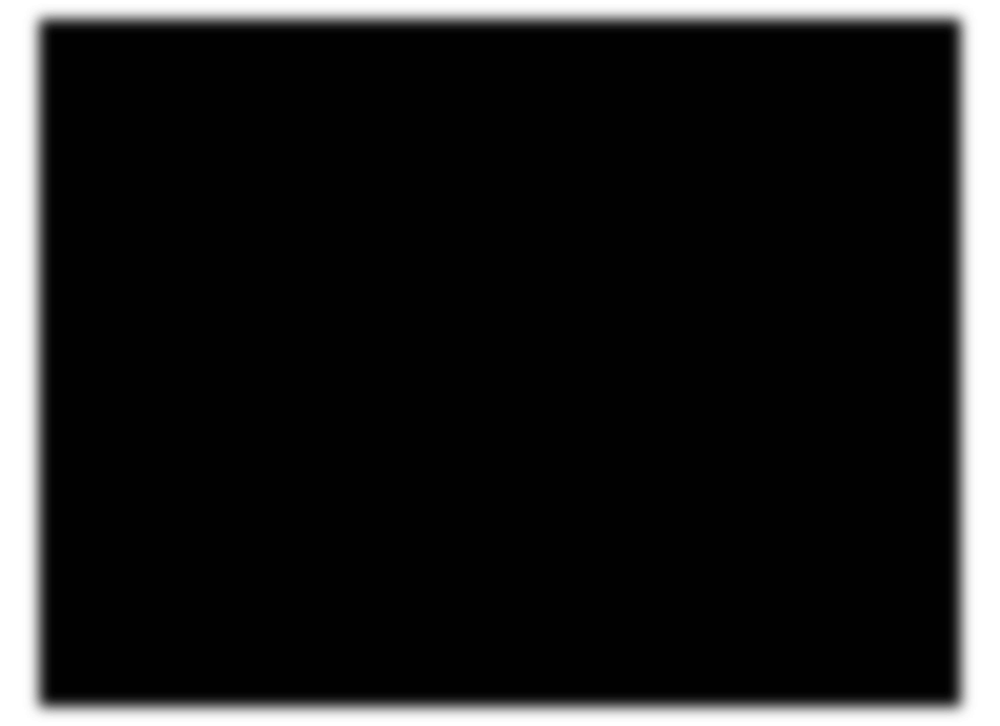

In [10]:
mask = make_smart_mask(init_img.width, init_img.height, 180, 80, 180, 80,
                       overlap=16, feather=32)

out_path =  f'mask.png'
mask.save(out_path)
print('Salvo:', out_path)

mask

Outpaint step 1: expand L128 T0 R128 B0


Token indices sequence length is longer than the specified maximum sequence length for this model (110 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['original photo and the outpainted areas. respect the original perspective, lighting direction, and depth cues. natural summer sunlight, crisp details, and cohesive color harmony.']


  0%|          | 0/100 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['original photo and the outpainted areas. respect the original perspective, lighting direction, and depth cues. natural summer sunlight, crisp details, and cohesive color harmony.']


Salvo: outpaint_results/outpaint_step_01.png
Outpaint step 2: expand L128 T0 R128 B0


  0%|          | 0/100 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['original photo and the outpainted areas. respect the original perspective, lighting direction, and depth cues. natural summer sunlight, crisp details, and cohesive color harmony.']


Salvo: outpaint_results/outpaint_step_02.png
Outpaint step 3: expand L128 T0 R128 B0


  0%|          | 0/100 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['original photo and the outpainted areas. respect the original perspective, lighting direction, and depth cues. natural summer sunlight, crisp details, and cohesive color harmony.']


Salvo: outpaint_results/outpaint_step_03.png
Outpaint step 4: expand L128 T0 R128 B0


  0%|          | 0/100 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['original photo and the outpainted areas. respect the original perspective, lighting direction, and depth cues. natural summer sunlight, crisp details, and cohesive color harmony.']


Salvo: outpaint_results/outpaint_step_04.png
Outpaint step 5: expand L0 T80 R0 B80


  0%|          | 0/100 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['original photo and the outpainted areas. respect the original perspective, lighting direction, and depth cues. natural summer sunlight, crisp details, and cohesive color harmony.']


Salvo: outpaint_results/outpaint_step_05.png
Outpaint step 6: expand L0 T80 R0 B80


  0%|          | 0/100 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['original photo and the outpainted areas. respect the original perspective, lighting direction, and depth cues. natural summer sunlight, crisp details, and cohesive color harmony.']


Salvo: outpaint_results/outpaint_step_06.png
Outpaint step 7: expand L0 T80 R0 B80


  0%|          | 0/100 [00:00<?, ?it/s]

Salvo: outpaint_results/outpaint_step_07.png


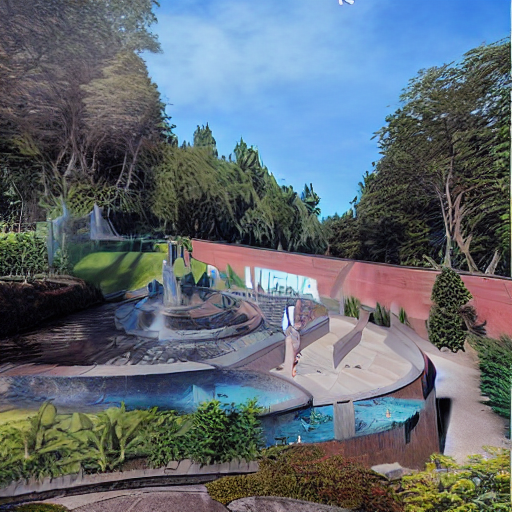

In [ ]:
prompt = """
A seamless and photorealistic continuation of the park environment.
Extend the dense green foliage, tall trees, and well-kept grass.
Preserve and smoothly extend the clear blue sky with natural soft gradients.
Continue the stone fountain, circular water pool, and reflective water surface with subtle ripples.
Maintain the warm stone textures and realistic architectural style.
Ensure perfectly smooth transitions between the original photo and the outpainted areas.
Respect the original perspective, lighting direction, and depth cues.
Natural summer sunlight, crisp details, and cohesive color harmony.
"""

negative_prompt = """
blurry, distorted, warped geometry, melted shapes,
extra people, extra limbs, surreal elements,
incorrect perspective, incorrect lighting, fantasy,
watermarks, repeating patterns, text
"""

final = incremental_outpaint(
  pipe=pipe,
  init_image=init_img,
  prompt=prompt,
  negative_prompt=negative_prompt,
  expand_steps=[
      (128, 0, 128, 0),
      (128, 0, 128, 0),
      (128, 0, 128, 0),
      (128, 0, 128, 0),
      (0, 80, 0, 80),
      (0, 80, 0, 80),
      (0, 80, 0, 80),
  ],
  guidance_scale=5.5,
  num_inference_steps=100,
  seed=42,
  output_dir='./outpaint_results'
)

final

In [ ]:
final_test1_resized = resize_to_original(
    final_img=final,
    original=init_img,
    output_path="./outpaint_final_test1_fixed/final_resize.png",
    sharpen=True
)
final_test1_resized

Output hidden; open in https://colab.research.google.com to view.

In [20]:
# ---------------------------
# NEGATIVE PROMPT (compartilhado)
# ---------------------------
neg = """
blurry, distorted, warped shapes, melted forms,
extra people, extra limbs, surreal elements,
incorrect perspective, incorrect lighting,
fantasy, watermarks, repeating patterns, text
"""

Outpaint step 1: expand L32 T0 R32 B0


  0%|          | 0/60 [00:00<?, ?it/s]

Salvo: outpaint_stage1_fixed/outpaint_step_01.png
Outpaint step 2: expand L48 T0 R64 B0


  0%|          | 0/60 [00:00<?, ?it/s]

Salvo: outpaint_stage1_fixed/outpaint_step_02.png


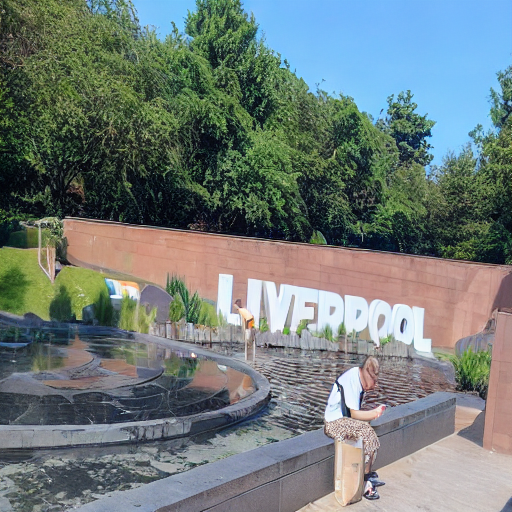

In [ ]:
# ============================================================
# ETAPA 1 — Estrutura e Perspectiva
# ============================================================
prompt_struct = """
Extend the scene with accurate geometry and perspective.
Continue the stone fountain edge and circular water pool.
Preserve reflections and water ripples realistically.
Maintain the same viewing angle and depth.
Do not invent new people or objects.
No mirrored patterns, no duplicated objects.
Consistent botanical structure.
"""

stage1 = incremental_outpaint(
   pipe=pipe,
    init_image=init_img,
    prompt=prompt_struct,
    negative_prompt=neg,
    expand_steps=[
        (32, 0, 32, 0),   # bem pequeno
        (48, 0, 64, 0),   # pequeno e mais simétrico
    ],
    guidance_scale=2.5,          # Geometria mais sólida
    num_inference_steps=60,      # Mais detalhes sem exagerar
    seed=42,
    output_dir='./outpaint_stage1_fixed'
)

stage1

Imagem ajustada e salva em: ./outpaint_stage1_fixed/stage1_resize.png  (4640x3472)


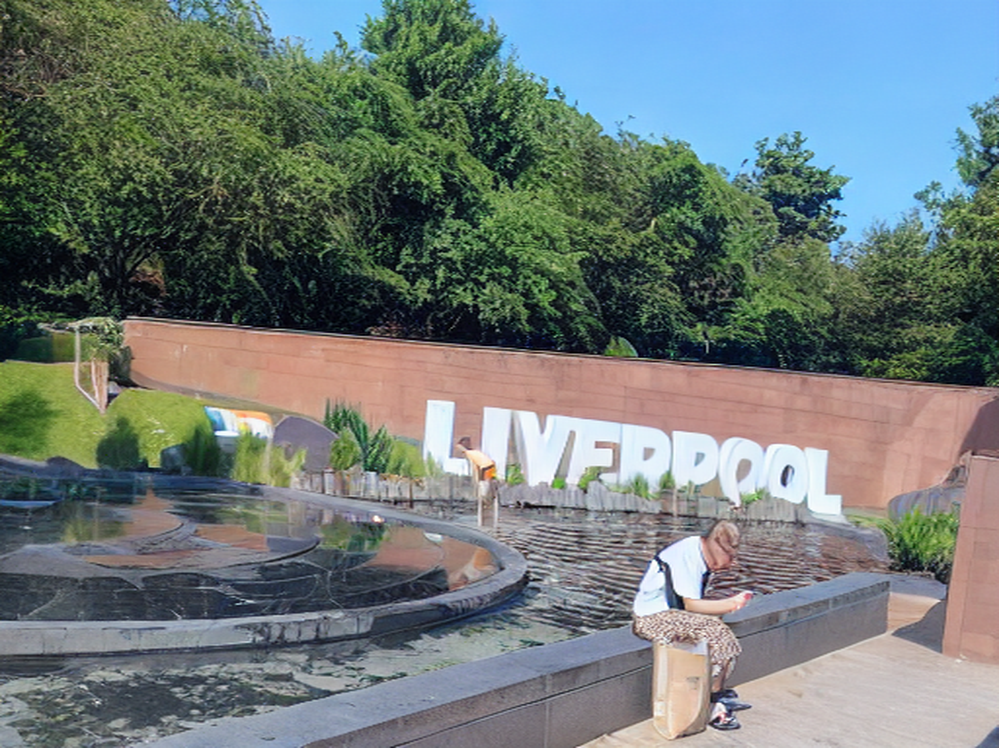

In [ ]:
stage1_resized = resize_to_original(
    final_img=stage1,
    original=init_img,
    output_path="./outpaint_stage1_fixed/stage1_resize.png",
    sharpen=True
)
stage1_resized

Outpaint step 1: expand L32 T0 R32 B0


  0%|          | 0/50 [00:00<?, ?it/s]

Salvo: outpaint_stage1_extended_fixed/outpaint_step_01.png
Outpaint step 2: expand L48 T0 R48 B0


  0%|          | 0/50 [00:00<?, ?it/s]

Salvo: outpaint_stage1_extended_fixed/outpaint_step_02.png
Outpaint step 3: expand L48 T0 R48 B0


  0%|          | 0/50 [00:00<?, ?it/s]

Salvo: outpaint_stage1_extended_fixed/outpaint_step_03.png
Outpaint step 4: expand L64 T0 R64 B0


  0%|          | 0/50 [00:00<?, ?it/s]

Salvo: outpaint_stage1_extended_fixed/outpaint_step_04.png
Outpaint step 5: expand L64 T0 R64 B0


  0%|          | 0/50 [00:00<?, ?it/s]

Salvo: outpaint_stage1_extended_fixed/outpaint_step_05.png
Outpaint step 6: expand L0 T12 R0 B12


  0%|          | 0/50 [00:00<?, ?it/s]

Salvo: outpaint_stage1_extended_fixed/outpaint_step_06.png
Outpaint step 7: expand L0 T8 R0 B8


  0%|          | 0/50 [00:00<?, ?it/s]

Salvo: outpaint_stage1_extended_fixed/outpaint_step_07.png


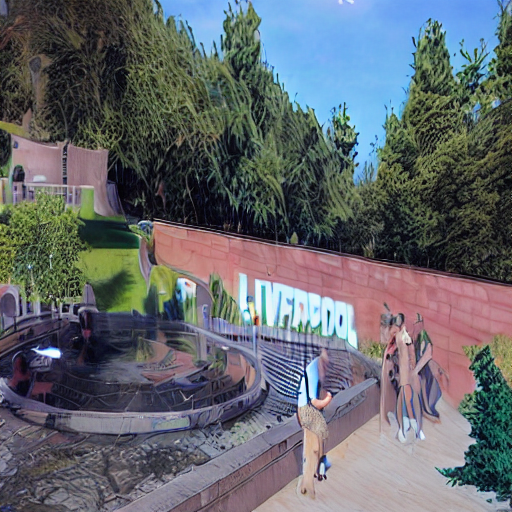

In [ ]:
# ============================================================
# ETAPA 1 — Estrutura e Perspectiva
# ============================================================
prompt_struct = """
Extend the scene with accurate geometry and perspective.
Continue the stone fountain edge and circular water pool.
Preserve reflections and water ripples realistically.
Maintain the same viewing angle and depth.
Do not invent new people or objects.
Make objects more clearly.
No mirrored patterns, no duplicated objects.
"""
# Consistent botanical structure.

stage1_extended = incremental_outpaint(
   pipe=pipe,
    init_image=init_img,
    prompt=prompt_struct,
    negative_prompt=neg,
    expand_steps=[
        (32, 0, 32, 0),   # bem pequeno
        (48, 0, 48, 0),   # pequeno e mais simétrico
        (48, 0, 48, 0),   # pequeno e mais simétrico
        (64, 0, 64, 0),   # pequeno e mais simétrico
        (64, 0, 64, 0),   # pequeno e mais simétrico
        (0, 12, 0, 12),
        (0, 8, 0, 8),
    ],
    guidance_scale=2.5,          # Geometria mais sólida
    num_inference_steps=50,      # Mais detalhes sem exagerar
    seed=42,
    output_dir='./outpaint_stage1_extended_fixed'
)

stage1_extended

In [ ]:
stage1_extended_resized = resize_to_original(
    final_img=stage1_extended,
    original=init_img,
    output_path="./outpaint_stage1_extended_fixed/stage1_extended_resize.png",
    sharpen=True
)
stage1_extended_resized

Output hidden; open in https://colab.research.google.com to view.

Outpaint step 1: expand L0 T80 R0 B80


  0%|          | 0/80 [00:00<?, ?it/s]

Salvo: outpaint_stage2/outpaint_step_01.png
Outpaint step 2: expand L0 T80 R0 B80


  0%|          | 0/80 [00:00<?, ?it/s]

Salvo: outpaint_stage2/outpaint_step_02.png


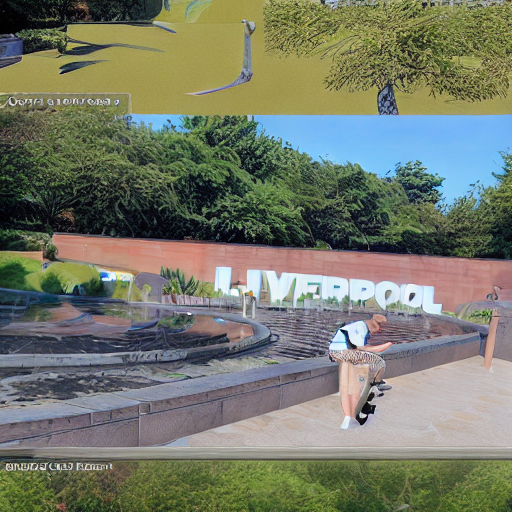

In [ ]:
# ============================================================
# ETAPA 2 — Vegetação e Ambiente Natural
# ============================================================
prompt_veg = """
Extend dense green foliage with realistic tree textures.
Smoothly continue grass, bushes, and natural shadows.
Maintain botanical coherence and summer coloration.
Create soft and clean transitions with previous content.
No mirrored patterns, no duplicated objects.
Consistent botanical structure.
"""

stage2 = incremental_outpaint(
    pipe=pipe,
    init_image=stage1,
    prompt=prompt_veg,
    negative_prompt=neg,
    expand_steps=[
        # extensão mais vertical para árvores e vegetação
        (0, 80, 0, 80),
        (0, 80, 0, 80),
    ],
    guidance_scale=6.0,
    num_inference_steps=80,
    seed=42,
    output_dir='./outpaint_stage2'
)

stage2

In [ ]:
stage2_resized = resize_to_original(
    final_img=stage2,
    original=init_img,
    output_path="./outpaint_stage2/stage2_resize.png",
    sharpen=True
)
stage2_resized

Outpaint step 1: expand L0 T12 R0 B12


  0%|          | 0/40 [00:00<?, ?it/s]

Salvo: outpaint_stage3/outpaint_step_01.png
Outpaint step 2: expand L0 T8 R0 B8


  0%|          | 0/40 [00:00<?, ?it/s]

Salvo: outpaint_stage3/outpaint_step_02.png


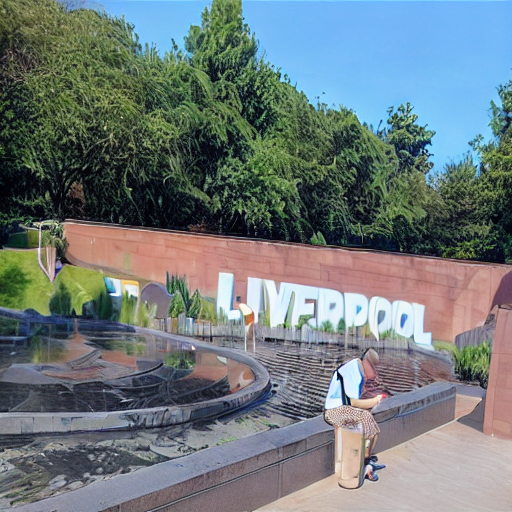

In [ ]:
# ============================================================
# ETAPA 3 — Céu, Luz e Polimento Final
# ============================================================
prompt_sky = """
Extend only the sky area with smooth, natural blue gradients.
Do not modify any part of the existing scene.
Preserve all vegetation, shadows, water reflections, and textures exactly as they are.
No restyling. No changes to geometry or colors of the original content.
No mirrored patterns, no duplicated objects.
Consistent botanical structure.
"""

final = incremental_outpaint(
    pipe=pipe,
    init_image=stage1,
    prompt=prompt_sky,
    negative_prompt=neg,
    expand_steps=[
        (0, 12, 0, 12),
        (0, 8, 0, 8),
    ],
    guidance_scale=2.0,
    num_inference_steps=40,
    seed=42,
    output_dir='./outpaint_stage3'
)

final

Imagem ajustada e salva em: ./outpaint_stage3/final_resize.png  (4640x3472)


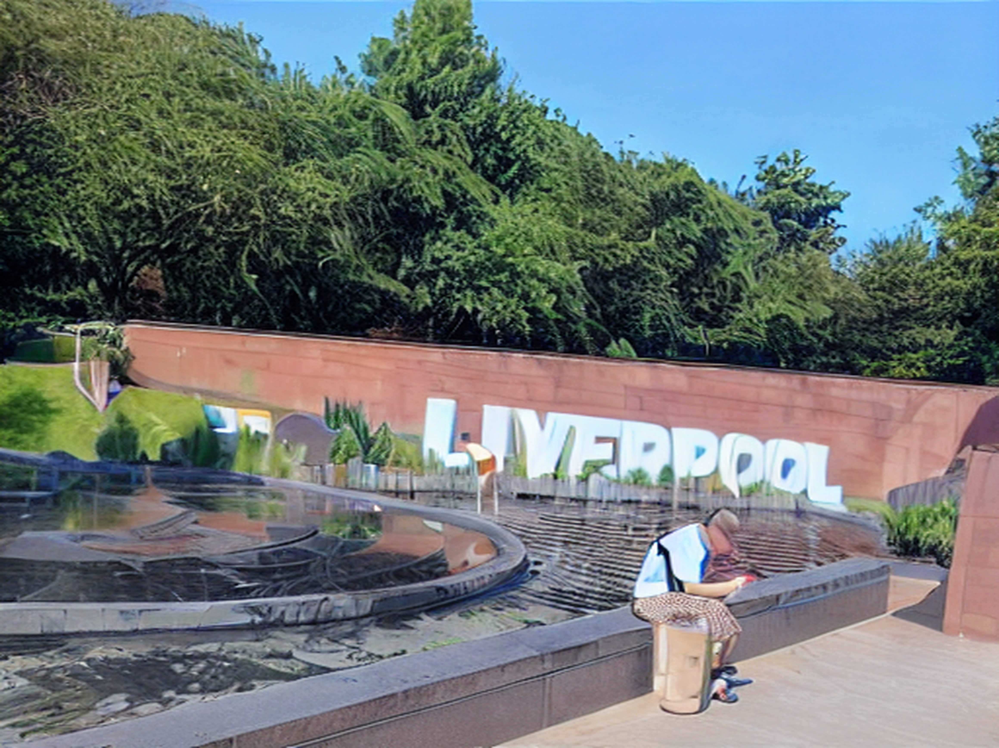

In [ ]:
final_resized = resize_to_original(
    final_img=final,
    original=init_img,
    output_path="./outpaint_stage3/final_resize.png",
    sharpen=True
)
final_resized

# Restauração de Imagens

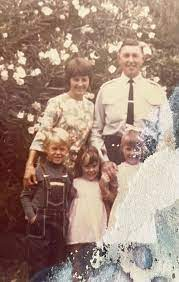

In [11]:
restore_path = 'images/to_restore3.jpg' # coloque sua imagem com esse nome na mesma pasta ou altere o caminho
if not Path(restore_path).exists():
  # criar uma imagem de exemplo simples
  img = Image.new('RGB', (512, 512), color=(120, 180, 240))
  d = ImageDraw.Draw(img)
  d.text((30, 30), 'Sample', fill=(255,255,255))
  img.save(restore_path)


restore_img = Image.open(restore_path)
restore_img

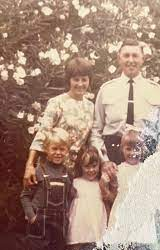

In [27]:
cropped_img = restore_img.crop((0, 0, 160, 250))

cropped_img.show()       # exibir
cropped_img.save("images/cropped.jpg")   # salvar

cropped_img

Outpaint step 1: expand L0 T0 R10 B10


  0%|          | 0/60 [00:00<?, ?it/s]

Salvo: outpaint_restore3_fixed/outpaint_step_01.png
Outpaint step 2: expand L0 T0 R10 B10


  0%|          | 0/60 [00:00<?, ?it/s]

Salvo: outpaint_restore3_fixed/outpaint_step_02.png


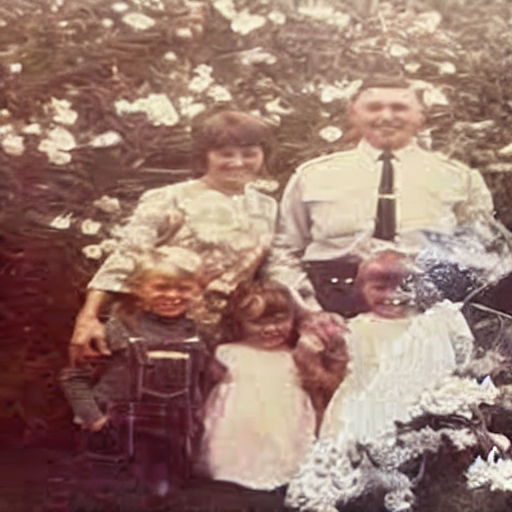

In [35]:
# ============================================================
# ETAPA RESTAURAÇÃO
# ============================================================
prompt_struct = """
Restore the old photo and remove the white damaged area, rebuilding the missing background naturally.
Preserve all original faces without distortion.
Maintain the vintage color, texture, and lighting.
Do not add new people or objects.
Reconstruct only the damaged region with realistic details consistent with the scene.
"""

restore3 = incremental_outpaint(
   pipe=pipe,
    init_image=cropped_img,
    prompt=prompt_struct,
    negative_prompt=neg,
    expand_steps=[
        (0, 0, 10, 10),     # pouco para a direita, pouco para baixo
        (0, 0, 10, 10),   # continua aumentando mais para baixo
    ],
    guidance_scale=4.5,          # Geometria mais sólida
    num_inference_steps=60,      # Mais detalhes sem exagerar
    overlap=12,
    seed=42,
    output_dir='./outpaint_restore3_fixed'
)

restore3

# Super Resolution

In [36]:
import os
from PIL import Image
import torch
from diffusers import StableDiffusionUpscalePipeline
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import structural_similarity, peak_signal_noise_ratio

device = "cuda" if torch.cuda.is_available() else "cpu"

pipe = StableDiffusionUpscalePipeline.from_pretrained(
    "stabilityai/stable-diffusion-x4-upscaler",
    torch_dtype=torch.float16 if device=="cuda" else torch.float32,
)
pipe = pipe.to(device)

model_index.json:   0%|          | 0.00/485 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

vocab.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/634 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/825 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/1.36G [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/300 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/348 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/982 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/1.89G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/587 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/221M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

In [40]:
def upscale_diffusion(img: Image.Image,
                      prompt="highly detailed, photorealistic",
                      steps=5,
                      scale=7.5):
    with torch.autocast("cuda"):
        out = pipe(
            prompt=prompt,
            image=img,
            num_inference_steps=steps,
            guidance_scale=scale
        )
    return out.images[0]

hr = upscale_diffusion(restore3)
hr

  0%|          | 0/5 [00:00<?, ?it/s]

OutOfMemoryError: CUDA out of memory. Tried to allocate 2.00 GiB. GPU 0 has a total capacity of 14.74 GiB of which 1.78 GiB is free. Process 13354 has 12.96 GiB memory in use. Of the allocated memory 11.33 GiB is allocated by PyTorch, and 1.50 GiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)